In [3]:
import pandas as pd
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
import warnings
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, classification_report, f1_score, mean_absolute_error, confusion_matrix, ConfusionMatrixDisplay  
from sklearn.preprocessing import RobustScaler, StandardScaler
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import cross_validate
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
import lightgbm
from lightgbm import LGBMClassifier
from sklearn.model_selection import StratifiedKFold
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from imblearn.under_sampling import RandomUnderSampler
from imblearn.over_sampling import RandomOverSampler
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import StratifiedShuffleSplit

In [4]:
#import data
df = pd.read_csv(r'fraud_oracle.csv')
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)

In [5]:
df.head()

,Month,WeekOfMonth,DayOfWeek,Make,AccidentArea,DayOfWeekClaimed,MonthClaimed,WeekOfMonthClaimed,Sex,MaritalStatus,Age,Fault,PolicyType,VehicleCategory,VehiclePrice,FraudFound_P,PolicyNumber,RepNumber,Deductible,DriverRating,Days_Policy_Accident,Days_Policy_Claim,PastNumberOfClaims,AgeOfVehicle,AgeOfPolicyHolder,PoliceReportFiled,WitnessPresent,AgentType,NumberOfSuppliments,AddressChange_Claim,NumberOfCars,Year,BasePolicy
0,Dec,5,Wednesday,Honda,Urban,Tuesday,Jan,1,Female,Single,21,Policy Holder,Sport - Liability,Sport,more than 69000,0,1,12,300,1,more than 30,more than 30,none,3 years,26 to 30,No,No,External,none,1 year,3 to 4,1994,Liability
1,Jan,3,Wednesday,Honda,Urban,Monday,Jan,4,Male,Single,34,Policy Holder,Sport - Collision,Sport,more than 69000,0,2,15,400,4,more than 30,more than 30,none,6 years,31 to 35,Yes,No,External,none,no change,1 vehicle,1994,Collision
2,Oct,5,Friday,Honda,Urban,Thursday,Nov,2,Male,Married,47,Policy Holder,Sport - Collision,Sport,more than 69000,0,3,7,400,3,more than 30,more than 30,1,7 years,41 to 50,No,No,External,none,no change,1 vehicle,1994,Collision
3,Jun,2,Saturday,Toyota,Rural,Friday,Jul,1,Male,Married,65,Third Party,Sedan - Liability,Sport,20000 to 29000,0,4,4,400,2,more than 30,more than 30,1,more than 7,51 to 65,Yes,No,External,more than 5,no change,1 vehicle,1994,Liability
4,Jan,5,Monday,Honda,Urban,Tuesday,Feb,2,Female,Single,27,Third Party,Sport - Collision,Sport,more than 69000,0,5,3,400,1,more than 30,more than 30,none,5 years,31 to 35,No,No,External,none,no change,1 vehicle,1994,Collision


In [6]:
df.shape

(15420, 33)

In [7]:
print(len(df.DriverRating)), print(len(df.Age))
df.NumberOfSuppliments.value_counts()

15420
15420


none           7047
more than 5    3867
1 to 2         2489
3 to 5         2017
Name: NumberOfSuppliments, dtype: int64

In [8]:
df.columns

Index(['Month', 'WeekOfMonth', 'DayOfWeek', 'Make', 'AccidentArea',
       'DayOfWeekClaimed', 'MonthClaimed', 'WeekOfMonthClaimed', 'Sex',
       'MaritalStatus', 'Age', 'Fault', 'PolicyType', 'VehicleCategory',
       'VehiclePrice', 'FraudFound_P', 'PolicyNumber', 'RepNumber',
       'Deductible', 'DriverRating', 'Days_Policy_Accident',
       'Days_Policy_Claim', 'PastNumberOfClaims', 'AgeOfVehicle',
       'AgeOfPolicyHolder', 'PoliceReportFiled', 'WitnessPresent', 'AgentType',
       'NumberOfSuppliments', 'AddressChange_Claim', 'NumberOfCars', 'Year',
       'BasePolicy'],
      dtype='object')

In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15420 entries, 0 to 15419
Data columns (total 33 columns):
 #   Column                Non-Null Count  Dtype 
---  ------                --------------  ----- 
 0   Month                 15420 non-null  object
 1   WeekOfMonth           15420 non-null  int64 
 2   DayOfWeek             15420 non-null  object
 3   Make                  15420 non-null  object
 4   AccidentArea          15420 non-null  object
 5   DayOfWeekClaimed      15420 non-null  object
 6   MonthClaimed          15420 non-null  object
 7   WeekOfMonthClaimed    15420 non-null  int64 
 8   Sex                   15420 non-null  object
 9   MaritalStatus         15420 non-null  object
 10  Age                   15420 non-null  int64 
 11  Fault                 15420 non-null  object
 12  PolicyType            15420 non-null  object
 13  VehicleCategory       15420 non-null  object
 14  VehiclePrice          15420 non-null  object
 15  FraudFound_P          15420 non-null

In [10]:
df.set_index('PolicyNumber')

,Month,WeekOfMonth,DayOfWeek,Make,AccidentArea,DayOfWeekClaimed,MonthClaimed,WeekOfMonthClaimed,Sex,MaritalStatus,Age,Fault,PolicyType,VehicleCategory,VehiclePrice,FraudFound_P,RepNumber,Deductible,DriverRating,Days_Policy_Accident,Days_Policy_Claim,PastNumberOfClaims,AgeOfVehicle,AgeOfPolicyHolder,PoliceReportFiled,WitnessPresent,AgentType,NumberOfSuppliments,AddressChange_Claim,NumberOfCars,Year,BasePolicy
PolicyNumber,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1,Dec,5,Wednesday,Honda,Urban,Tuesday,Jan,1,Female,Single,21,Policy Holder,Sport - Liability,Sport,more than 69000,0,12,300,1,more than 30,more than 30,none,3 years,26 to 30,No,No,External,none,1 year,3 to 4,1994,Liability
2,Jan,3,Wednesday,Honda,Urban,Monday,Jan,4,Male,Single,34,Policy Holder,Sport - Collision,Sport,more than 69000,0,15,400,4,more than 30,more than 30,none,6 years,31 to 35,Yes,No,External,none,no change,1 vehicle,1994,Collision
3,Oct,5,Friday,Honda,Urban,Thursday,Nov,2,Male,Married,47,Policy Holder,Sport - Collision,Sport,more than 69000,0,7,400,3,more than 30,more than 30,1,7 years,41 to 50,No,No,External,none,no change,1 vehicle,1994,Collision
4,Jun,2,Saturday,Toyota,Rural,Friday,Jul,1,Male,Married,65,Third Party,Sedan - Liability,Sport,20000 to 29000,0,4,400,2,more than 30,more than 30,1,more than 7,51 to 65,Yes,No,External,more than 5,no change,1 vehicle,1994,Liability
5,Jan,5,Monday,Honda,Urban,Tuesday,Feb,2,Female,Single,27,Third Party,Sport - Collision,Sport,more than 69000,0,3,400,1,more than 30,more than 30,none,5 years,31 to 35,No,No,External,none,no change,1 vehicle,1994,Collision
6,Oct,4,Friday,Honda,Urban,Wednesday,Nov,1,Male,Single,20,Third Party,Sport - Collision,Sport,more than 69000,0,12,400,3,more than 30,more than 30,none,5 years,21 to 25,No,No,External,3 to 5,no change,1 vehicle,1994,Collision
7,Feb,1,Saturday,Honda,Urban,Monday,Feb,3,Male,Married,36,Third Party,Sport - Collision,Sport,more than 69000,0,14,400,1,more than 30,more than 30,1,7 years,36 to 40,No,No,External,1 to 2,no change,1 vehicle,1994,Collision
8,Nov,1,Friday,Honda,Urban,Tuesday,Mar,4,Male,Single,0,Policy Holder,Sport - Collision,Sport,more than 69000,0,1,400,4,more than 30,more than 30,1,new,16 to 17,No,No,External,none,no change,1 vehicle,1994,Collision
9,Dec,4,Saturday,Honda,Urban,Wednesday,Dec,5,Male,Single,30,Policy Holder,Sport - Collision,Sport,more than 69000,0,7,400,4,more than 30,more than 30,none,6 years,31 to 35,No,Yes,External,3 to 5,no change,1 vehicle,1994,Collision


In [11]:
df.nunique()

Month                      12
WeekOfMonth                 5
DayOfWeek                   7
Make                       19
AccidentArea                2
DayOfWeekClaimed            8
MonthClaimed               13
WeekOfMonthClaimed          5
Sex                         2
MaritalStatus               4
Age                        66
Fault                       2
PolicyType                  9
VehicleCategory             3
VehiclePrice                6
FraudFound_P                2
PolicyNumber            15420
RepNumber                  16
Deductible                  4
DriverRating                4
Days_Policy_Accident        5
Days_Policy_Claim           4
PastNumberOfClaims          4
AgeOfVehicle                8
AgeOfPolicyHolder           9
PoliceReportFiled           2
WitnessPresent              2
AgentType                   2
NumberOfSuppliments         4
AddressChange_Claim         5
NumberOfCars                5
Year                        3
BasePolicy                  3
dtype: int

# Explanatory Data Analysis


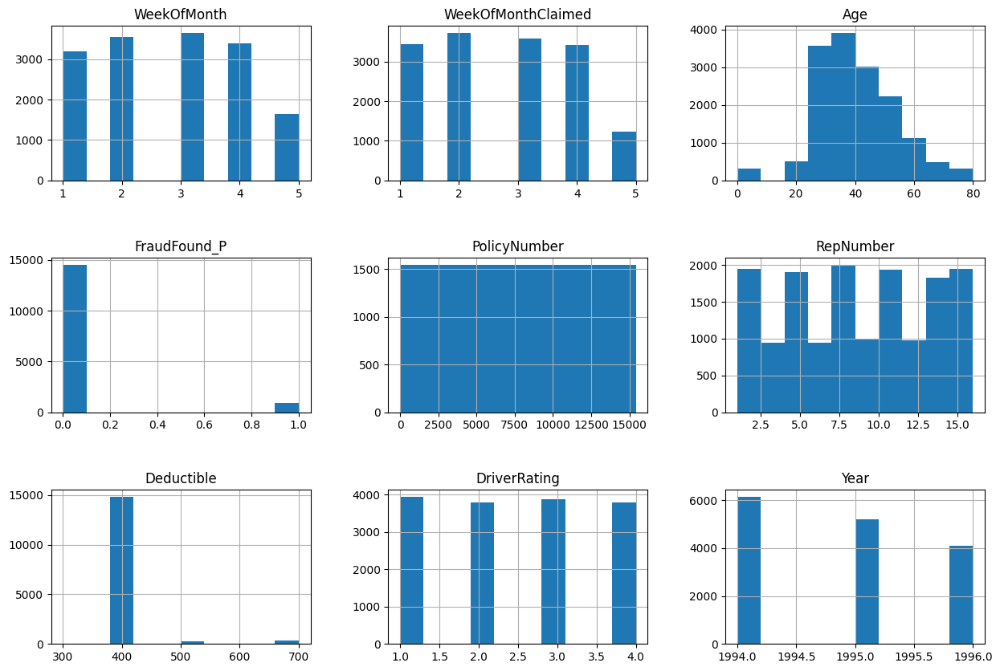

In [12]:
df.hist(figsize=(15,10))
plt.subplots_adjust(hspace=0.5);

**FraudFound_P**

In [13]:
print("The number of non fraudster claims is: ",len(df[df['FraudFound_P'] == 0]))
print("The percentage of non fraudster claims is: {}% ".format(round((len(df[df['FraudFound_P'] == 0])/len(df['FraudFound_P'])),4)*100))     
print("----"*10)

The number of non fraudster claims is:  14497
The percentage of non fraudster claims is: 94.01% 
----------------------------------------


In [14]:
print("The number of fraudster claims is: ",len(df[df['FraudFound_P'] == 1]))
print("The percentage of fraudster claims is: {}% ".format(round((len(df[df['FraudFound_P'] == 1])/len(df['FraudFound_P'])),4)*100))     
print("----"*10)

The number of fraudster claims is:  923
The percentage of fraudster claims is: 5.99% 
----------------------------------------


In [15]:
print("The number of total claims is: ",len(df['FraudFound_P']))

The number of total claims is:  15420


**Month**

In [16]:
item_counts = df['Month'].value_counts(normalize=True)
print("Percentage distribution among months")
print(round((item_counts*100),2))

Percentage distribution among months
Jan    9.15
May    8.87
Mar    8.82
Jun    8.57
Oct    8.46
Dec    8.33
Apr    8.30
Feb    8.21
Jul    8.15
Sep    8.04
Nov    7.79
Aug    7.31
Name: Month, dtype: float64


In [17]:
#Reframing MonthsName
df_month = df.groupby(['Month']).size().reset_index().rename(columns={0:'Num_accidents'})
df_month

,Month,Num_accidents
0,Apr,1280
1,Aug,1127
2,Dec,1285
3,Feb,1266
4,Jan,1411
5,Jul,1257
6,Jun,1321
7,Mar,1360
8,May,1367
9,Nov,1201


In [18]:
#Reframing the order of months' names
df['MonthName'] = pd.Categorical(df['Month'], ['Jan', 'Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov','Dec'])

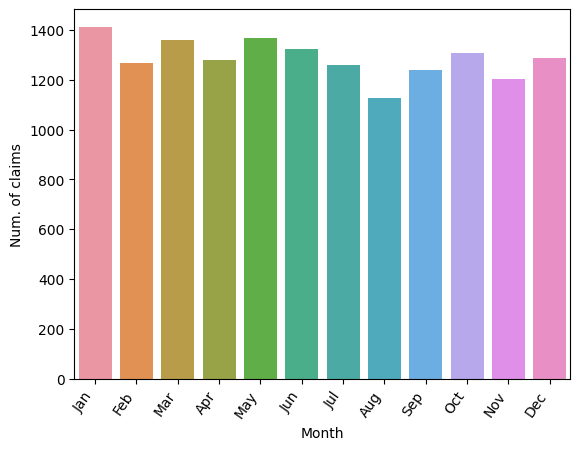

In [19]:
sns.countplot(data =df['Month'], x = df['MonthName'])
plt.xticks(rotation = 55, horizontalalignment='right')
plt.ylabel('Num. of claims')
plt.xlabel('Month')
plt.show()

In [20]:
df[['Month','FraudFound_P']].groupby(['Month','FraudFound_P']).size().reset_index()

,Month,FraudFound_P,0
0,Apr,0,1200
1,Apr,1,80
2,Aug,0,1043
3,Aug,1,84
4,Dec,0,1223
5,Dec,1,62
6,Feb,0,1184
7,Feb,1,82
8,Jan,0,1324
9,Jan,1,87


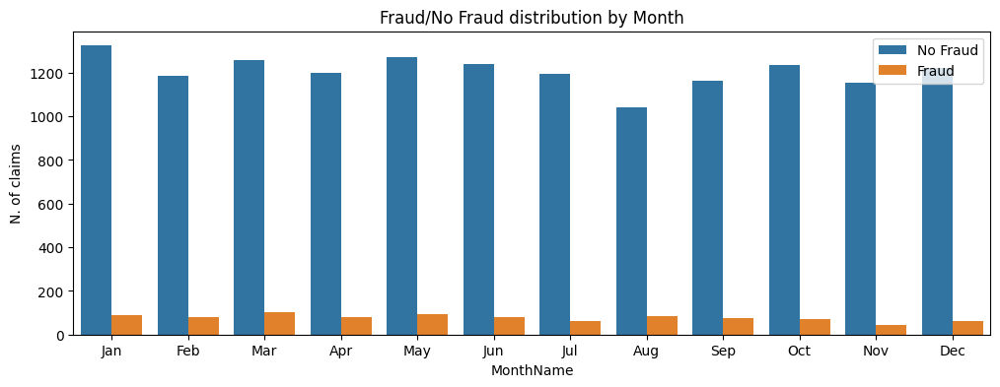

In [21]:
plt.figure(figsize=(12, 4))
labels = ['No Fraud', 'Fraud']
sns.countplot(x="MonthName", hue ='FraudFound_P', data=df)

plt.legend(labels)
plt.title('Fraud/No Fraud distribution by Month')

plt.ylabel('N. of claims')
plt.show()

**Car makers**

In [22]:
Make = df['Make'].value_counts()
Make

Pontiac      3837
Toyota       3121
Honda        2801
Mazda        2354
Chevrolet    1681
Accura        472
Ford          450
VW            283
Dodge         109
Saab          108
Mercury        83
Saturn         58
Nisson         30
BMW            15
Jaguar          6
Porche          5
Mecedes         4
Ferrari         2
Lexus           1
Name: Make, dtype: int64

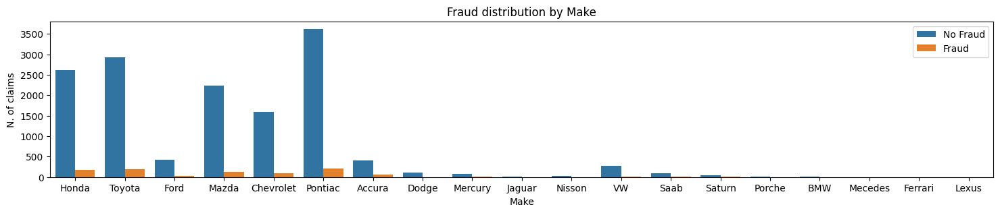

In [23]:
plt.figure(figsize=(18,3))

df_fraud = df.loc[df['FraudFound_P']==1]
df_no_fraud = df.loc[df['FraudFound_P']==0]

sns.countplot(x="Make" , hue = 'FraudFound_P', data= df)

labels = ['No Fraud', 'Fraud']
plt.legend(labels)
plt.title('Fraud distribution by Make')
plt.xlabel('Make')
plt.ylabel('N. of claims')
plt.show()

**Accident Area**

In [24]:
df['AccidentArea'].value_counts()

Urban    13822
Rural     1598
Name: AccidentArea, dtype: int64

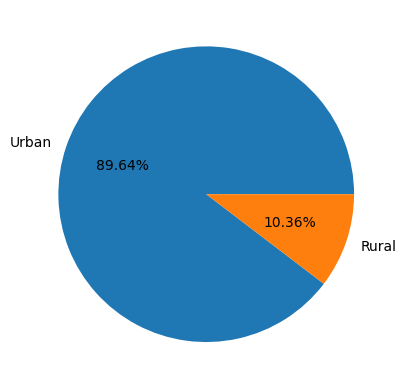

In [25]:
Accident_Area = df.AccidentArea.value_counts().values 
labels = ['Urban', 'Rural']
plt.pie(Accident_Area, labels = labels, autopct = '%1.2f%%')
plt.show()

In [26]:
cats = ['Rural', 'Urban']
df['AreaType'] = pd.Categorical(df['AccidentArea'], categories=cats, ordered=True)
df = df.sort_values('AreaType')

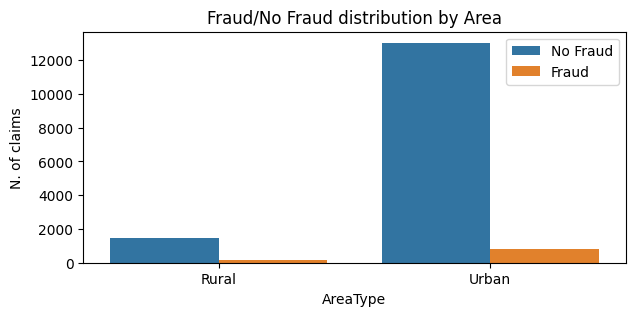

In [27]:
df_fraud = df.loc[df['FraudFound_P']==1]
df_no_fraud = df.loc[df['FraudFound_P']==0]
plt.figure(figsize=(7,3))
labels = ['No Fraud', 'Fraud']
sns.countplot(x="AreaType", hue ='FraudFound_P', data=df)


plt.legend(labels)
plt.title('Fraud/No Fraud distribution by Area')

plt.ylabel('N. of claims')
plt.show()

**Sex**

In [28]:
df['Sex'].value_counts()

Male      13000
Female     2420
Name: Sex, dtype: int64

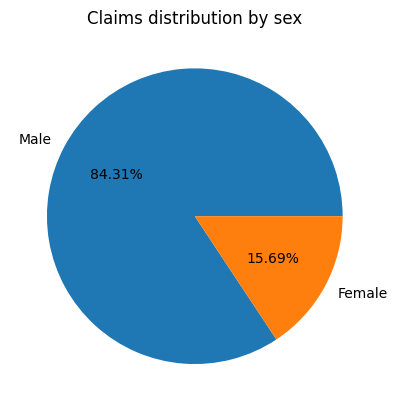

In [29]:
Sex = df['Sex'].value_counts() 
labels = ['Male','Female']
plt.pie(Sex,labels = labels, autopct = '%1.2f%%')
plt.title('Claims distribution by sex')
plt.show()

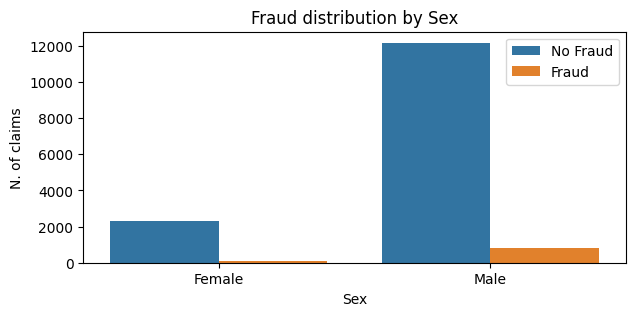

In [30]:
plt.figure(figsize=(7, 3))
labels = ['No Fraud', 'Fraud']
sns.countplot(x="Sex",hue="FraudFound_P" ,data=df)
plt.legend(labels)
plt.title('Fraud distribution by Sex')

plt.ylabel('N. of claims')
plt.show()

In [31]:
df[df.Sex=='Male']['FraudFound_P'].value_counts()

0    12182
1      818
Name: FraudFound_P, dtype: int64

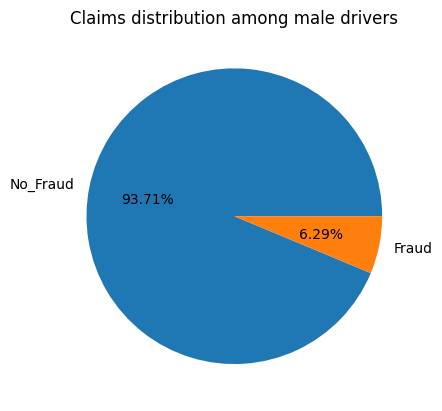

In [32]:
Male = df[df.Sex=='Male']['FraudFound_P'].value_counts() 
labels = ['No_Fraud','Fraud']
plt.pie(Male,labels = labels, autopct = '%1.2f%%')
plt.title('Claims distribution among male drivers')
plt.show()

In [33]:
df[df.Sex=='Female']['FraudFound_P'].value_counts()

0    2315
1     105
Name: FraudFound_P, dtype: int64

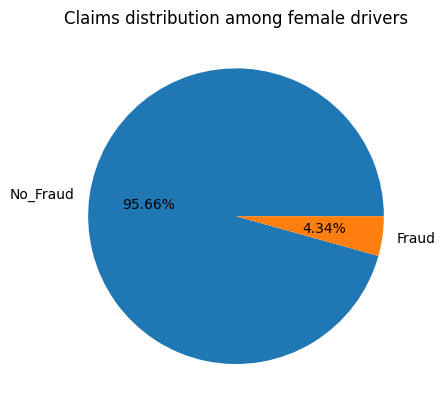

In [34]:
Female = df[df.Sex=='Female']['FraudFound_P'].value_counts() 
labels = ['No_Fraud','Fraud']
plt.pie(Female,labels = labels, autopct = '%1.2f%%')
plt.title('Claims distribution among female drivers')
plt.show()

**Marital Status**

In [35]:
df['MaritalStatus'].value_counts()

Married     10625
Single       4684
Divorced       76
Widow          35
Name: MaritalStatus, dtype: int64

In [36]:
df.groupby(['MaritalStatus', 'FraudFound_P']).size().reset_index().head(10)

,MaritalStatus,FraudFound_P,0
0,Divorced,0,73
1,Divorced,1,3
2,Married,0,9986
3,Married,1,639
4,Single,0,4406
5,Single,1,278
6,Widow,0,32
7,Widow,1,3


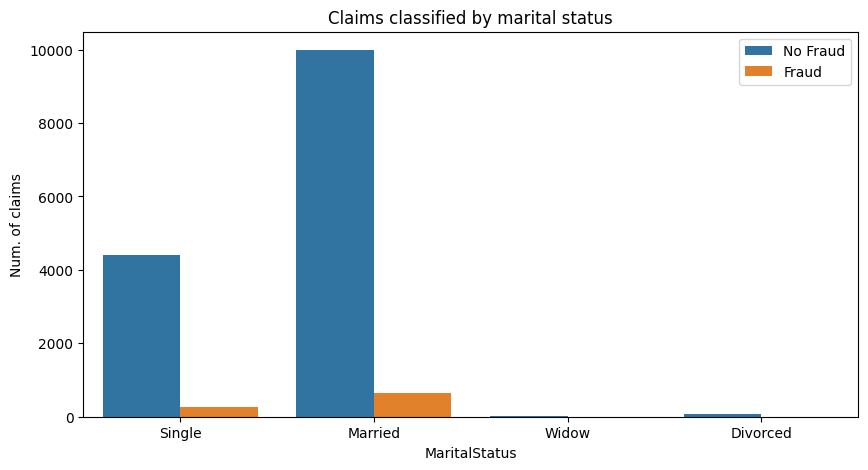

In [37]:
plt.figure(figsize = (10,5))
sns.countplot(x = 'MaritalStatus', hue = 'FraudFound_P', data = df)
plt.title('Claims classified by marital status')
plt.legend(labels =['No Fraud','Fraud'])
plt.ylabel('Num. of claims')
plt.show()

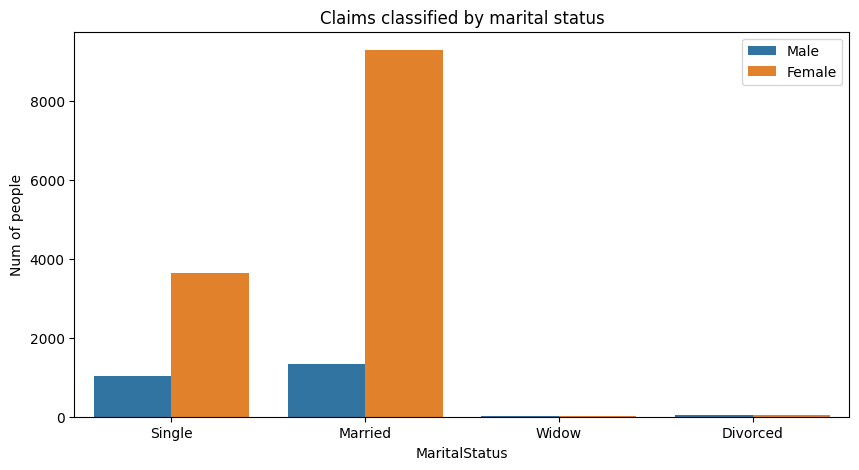

In [38]:
plt.figure(figsize = (10,5))
sns.countplot(x = 'MaritalStatus', hue = 'Sex', data = df)
plt.title('Claims classified by marital status')
plt.legend(labels =['Male','Female'])
plt.ylabel('Num of people')
plt.show()

**Age**

In [39]:
df[df['Age']<=15].count()

Month                   320
WeekOfMonth             320
DayOfWeek               320
Make                    320
AccidentArea            320
DayOfWeekClaimed        320
MonthClaimed            320
WeekOfMonthClaimed      320
Sex                     320
MaritalStatus           320
Age                     320
Fault                   320
PolicyType              320
VehicleCategory         320
VehiclePrice            320
FraudFound_P            320
PolicyNumber            320
RepNumber               320
Deductible              320
DriverRating            320
Days_Policy_Accident    320
Days_Policy_Claim       320
PastNumberOfClaims      320
AgeOfVehicle            320
AgeOfPolicyHolder       320
PoliceReportFiled       320
WitnessPresent          320
AgentType               320
NumberOfSuppliments     320
AddressChange_Claim     320
NumberOfCars            320
Year                    320
BasePolicy              320
MonthName               320
AreaType                320
dtype: int64

In [40]:
df = df[df['Age']>15]


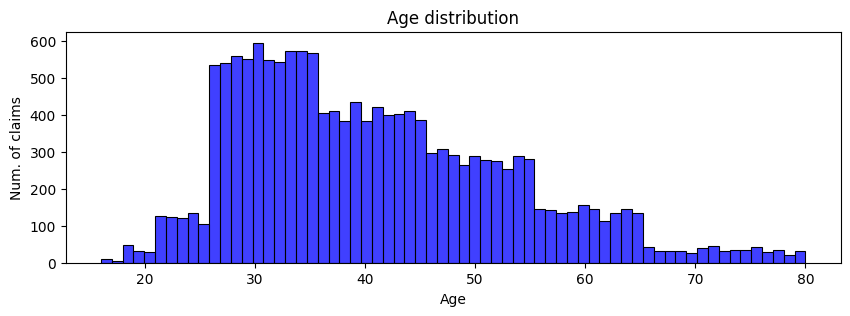

In [41]:
plt.figure(figsize=(10,3))
sns.histplot(data = df, x = 'Age', color = 'blue', bins =65 )
#plt.legend(["No Fraud", "Fraud"])
plt.ylabel("Num. of claims")
plt.title('Age distribution')

plt.show()

<ipython-input-42-fbcd76eb36dd>:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(df.corr(),linewidths=0.25,vmax=1.0, square=True, cmap="coolwarm", linecolor='black', annot=True)


<Axes: >

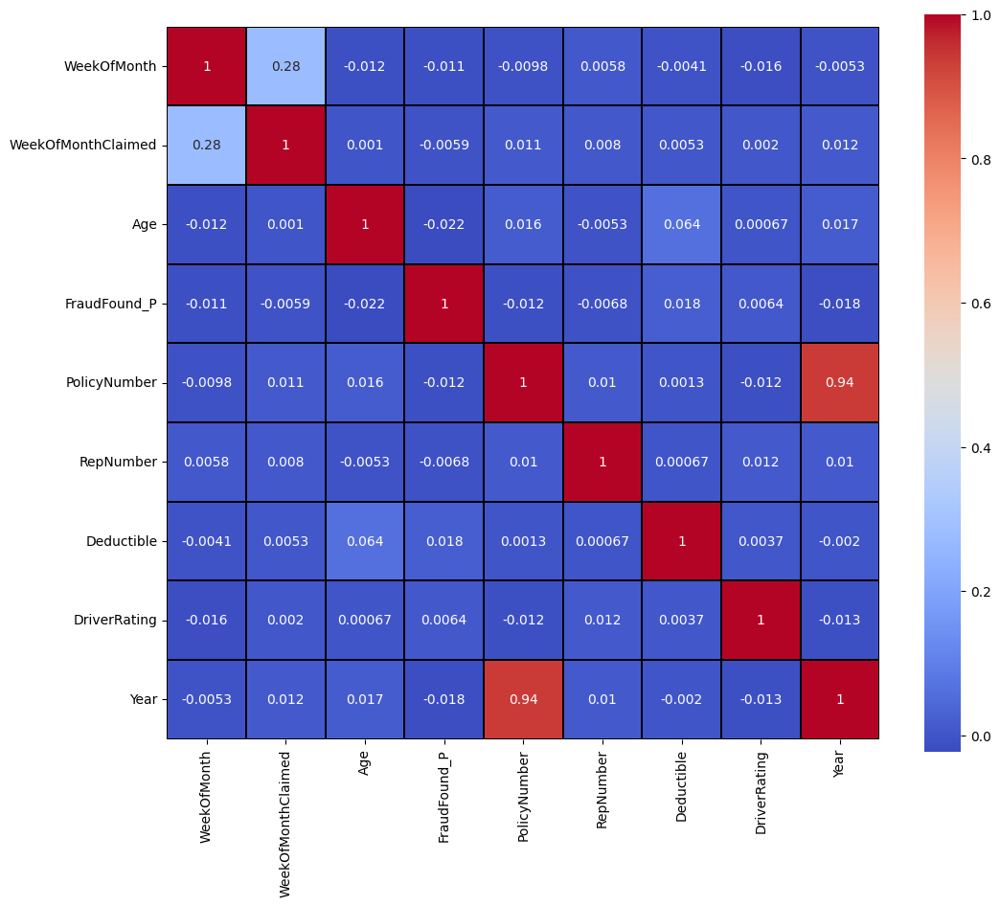

In [42]:
f, ax = plt.subplots(figsize=(12, 10))
sns.heatmap(df.corr(),linewidths=0.25,vmax=1.0, square=True, cmap="coolwarm", linecolor='black', annot=True)

# Data pre-processing


Encoding

In [43]:
object_type_feature = []

for features in df.columns:
    if df[features].dtype == 'O':
       object_type_feature.append(features)

print(object_type_feature)

['Month', 'DayOfWeek', 'Make', 'AccidentArea', 'DayOfWeekClaimed', 'MonthClaimed', 'Sex', 'MaritalStatus', 'Fault', 'PolicyType', 'VehicleCategory', 'VehiclePrice', 'Days_Policy_Accident', 'Days_Policy_Claim', 'PastNumberOfClaims', 'AgeOfVehicle', 'AgeOfPolicyHolder', 'PoliceReportFiled', 'WitnessPresent', 'AgentType', 'NumberOfSuppliments', 'AddressChange_Claim', 'NumberOfCars', 'BasePolicy']


In [44]:
print(len(object_type_feature))

24


In [45]:
df.groupby('VehicleCategory').size().sort_values()

VehicleCategory
Utility     382
Sport      5208
Sedan      9510
dtype: int64

In [46]:
df[['Month']] = df[['Month']].replace( {
    'Jan' : 0,
    'Feb' : 1,
    'Mar' :2,
    'Apr' : 3,
    'May': 4, 
    'Jun': 5,
    'Jul': 6,
    'Aug' : 7,
    'Sep': 8,
    'Oct' : 9,
    'Nov' : 10,
    'Dec' : 11
    })

In [47]:
df[['DayOfWeek']] = df[['DayOfWeek']].replace( {
    'Monday': 0,
    'Tuesday': 1,
    'Wednesday': 2,
    'Thursday': 3,
    'Friday': 4, 
    'Saturday': 5,
    'Sunday' : 6
    })

In [48]:
df[['Make']] = df[['Make']].replace( {
    'Lexus': 0,
    'Ferrari': 1, 
    'Mecedes': 2,
    'Porche': 3,
    'Jaguar': 4,
    'BMW': 5,            
    'Nisson': 6,
    'Saturn': 7,
    'Mercury':8,
    'Dodge' : 9,
    'Saab' : 10,
    'VW' : 11,
    'Ford': 12,
    'Accura': 13,
    'Chevrolet': 14,
    'Mazda' : 15,
    'Honda' : 16,
    'Toyota' : 17,
    'Pontiac': 18
    })     

In [49]:
df[['AccidentArea']] = df[['AccidentArea']].replace( {
    'Rural' : 0,
    'Urban' : 1
    })

In [50]:
df[['DayOfWeekClaimed']] = df[['DayOfWeekClaimed']].replace( {
    'Monday': 0,
    'Tuesday': 1,
    'Wednesday': 2,
    'Thursday': 3,
    'Friday': 4, 
    'Saturday': 5,
    'Sunday' : 6
    })

In [51]:
df[['MonthClaimed']] = df[['MonthClaimed']].replace( {
    'Jan' : 0,
    'Feb' : 1,
    'Mar' :2,
    'Apr' : 3,
    'May': 4, 
    'Jun': 5,
    'Jul': 6,
    'Aug' : 7,
    'Sep': 8,
    'Oct' : 9,
    'Nov' : 10,
    'Dec' : 11
    })

In [52]:
df[['Sex']] = df[['Sex']].replace( {
    'Female' : 0,
    'Male' : 1
    })


In [53]:
df[['MaritalStatus']] = df[['MaritalStatus']].replace( {
    'Widow' : 0,
    'Divorced' : 1,
    'Single' : 2,    
    'Married' : 3
    })

In [54]:
df[['Fault']] = df[['Fault']].replace( {
    'Third Party' : 0,
    'Policy Holder' : 1
    })

In [55]:
df[['PolicyType']] = df[['PolicyType']].replace( {
    'Sport - Liability' : 0,
    'Sport - All Perils' : 1,
    'Utility - Liability' : 2,
    'Utility - Collision' :3,
    'Utility - All Perils' :4,
    'Sport - Collision' : 5,
    'Sedan - All Perils' : 6 ,
    'Sedan - Liability' : 7,
    'Sedan - Collision' : 8
    })

In [56]:
df[['VehicleCategory']] = df[['VehicleCategory']].replace( {
    'Utility' : 0,
    'Sport' : 1, 
    'Sedan' : 2
    })

In [57]:
df[['VehiclePrice']] = df[['VehiclePrice']].replace( {
    'less than 20000' : 0,
    '20000 to 29000': 1,
    '30000 to 39000': 2,
    '40000 to 59000': 3,
    '60000 to 69000' : 4,
    'more than 69000' : 5
    })

In [58]:
df[['Days_Policy_Accident']] = df[['Days_Policy_Accident']].replace( {
    'none' : 0,
    '1 to 7' : 1,
    '8 to 15' : 2,
    '15 to 30' :3,
    'more than 30' :4
    })

In [59]:
df[['Days_Policy_Claim']] = df[['Days_Policy_Claim']].replace( {
    '8 to 15' : 0,
    '15 to 30' : 1,
    'more than 30' : 2
    })

In [60]:
df[['PastNumberOfClaims']] = df[['PastNumberOfClaims']].replace( {
    'none': 0,
    '1': 1,
    '2 to 4': 2,
    'more than 4': 3
    })

In [61]:
df[['AgeOfVehicle']] = df[['AgeOfVehicle']].replace({
    'new' : 0,
    '2 years' : 1,
    '3 years' : 2,
    '4 years' : 3,
    '5 years' : 4, 
    '6 years' : 5,
    '7 years' : 6,      
    'more than 7' : 7
    })

In [62]:
df[['AgeOfPolicyHolder']] = df[['AgeOfPolicyHolder']].replace({
    '18 to 20' : 0,  
    '21 to 25' : 1,
    '26 to 30' : 2,
    '31 to 35' : 3,
    '36 to 40' : 4,
    '41 to 50' : 5,
    '51 to 65' : 6, 
    'over 65' : 7
    })

In [63]:
df[['PoliceReportFiled']] = df[['PoliceReportFiled']].replace({
    'Yes' : 0,
    'No' : 1
    })

In [64]:
df[['WitnessPresent']] = df[['WitnessPresent']].replace({
    'Yes' : 0,
    'No' : 1
    })

In [65]:
df[['AgentType']] = df[['AgentType']].replace({
    'Internal' : 0,
    'External' : 1
    })

In [66]:
df[['NumberOfSuppliments']] = df[['NumberOfSuppliments']].replace({
    'none' : 0,
    '1 to 2' : 1,
    '3 to 5' : 2,
    'more than 5' : 3
    })

In [67]:
df[['AddressChange_Claim']] = df[['AddressChange_Claim']].replace({
    'no change' : 0,
    'under 6 months' : 1,
    '1 year' : 2,
    '2 to 3 years' : 3,
    '4 to 8 years' : 4
    })

In [68]:
df[['NumberOfCars']] = df[['NumberOfCars']].replace({
    '1 vehicle' : 0,
    '2 vehicles' : 1,
    '3 to 4' : 2,
    '5 to 8' : 3,
    'more than 8' : 4
    })

In [69]:
df[['BasePolicy']] = df[['BasePolicy']].replace({
    'All Perils' : 0, 
    'Liability' : 1,
    'Collision' : 2 
    })

In [70]:
df[['MonthName']] = df[['MonthName']].replace( {
    'Jan' : 0,
    'Feb' : 1,
    'Mar' : 2,
    'Apr' : 3,
    'May' : 4, 
    'Jun' : 5,
    'Jul' : 6,
    'Aug' : 7,
    'Sep' : 8,
    'Oct' : 9,
    'Nov' : 10,
    'Dec' : 11
    })

In [71]:
df[['AreaType']] = df[['AreaType']].replace( {
    'Rural' : 0,
    'Urban' : 1
    })

In [72]:
df.head()

,Month,WeekOfMonth,DayOfWeek,Make,AccidentArea,DayOfWeekClaimed,MonthClaimed,WeekOfMonthClaimed,Sex,MaritalStatus,Age,Fault,PolicyType,VehicleCategory,VehiclePrice,FraudFound_P,PolicyNumber,RepNumber,Deductible,DriverRating,Days_Policy_Accident,Days_Policy_Claim,PastNumberOfClaims,AgeOfVehicle,AgeOfPolicyHolder,PoliceReportFiled,WitnessPresent,AgentType,NumberOfSuppliments,AddressChange_Claim,NumberOfCars,Year,BasePolicy,MonthName,AreaType
7709,10,2,1,16,0,3,10,3,0,2,37,1,6,2,1,0,7710,4,400,4,4,2,1,6,4,1,1,1,3,0,0,1995,0,10,0
6322,3,4,0,15,0,2,5,2,1,3,33,1,6,2,2,0,6323,9,400,1,4,2,1,5,3,1,1,1,0,0,0,1995,0,3,0
9758,1,3,0,13,0,1,1,4,1,3,30,1,7,1,2,0,9759,1,400,4,4,2,0,6,3,1,1,1,3,0,2,1995,1,1,0
13386,10,2,5,16,0,1,10,3,1,2,35,1,8,2,2,0,13387,11,400,4,4,2,2,5,3,1,1,1,0,0,0,1996,2,10,0
13385,10,3,2,17,0,3,10,3,0,3,37,0,8,2,1,0,13386,15,400,3,4,2,0,5,4,1,1,1,3,0,0,1996,2,10,0


**Data preparation**

In [73]:
X = df.drop(columns = 'FraudFound_P', axis = 1)
Y = df.FraudFound_P

**Train and test split**

In [74]:
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state = 35)
X_train.shape, X_test.shape, X.shape

((12080, 34), (3020, 34), (15100, 34))

# implement multiple classification models using the Scikit-Learn package to predict if a claim application is fraudulent or not

**Logistic Regression**

In [75]:
model_lr = LogisticRegression(max_iter=5000)
model_lr.fit(X_train, Y_train)

LogisticRegression(max_iter=5000)

In [76]:
X_train_prediction = model_lr.predict(X_train)
train_data_accuracy = accuracy_score(X_train_prediction, Y_train)
print('The training set accuracy is: ',train_data_accuracy)

The training set accuracy is:  0.9396523178807947


In [77]:
X_test_prediction = model_lr.predict(X_test)
test_data_accuracy = accuracy_score(X_test_prediction, Y_test )
print('The test set accuracy is: ',test_data_accuracy)

The test set accuracy is:  0.9440397350993377


In [78]:
prediction_lr = model_lr.predict(X)
accuracy_lr = accuracy_score(prediction_lr, Y )
print('The whole dataset accuracy is: ',accuracy_lr)

The whole dataset accuracy is:  0.9405298013245033


In [79]:
print("LR MAE: ",mean_absolute_error(Y, prediction_lr))

LR MAE:  0.05947019867549669


In [80]:
print(classification_report(Y_test, X_test_prediction))

              precision    recall  f1-score   support

           0       0.94      1.00      0.97      2853
           1       0.00      0.00      0.00       167

    accuracy                           0.94      3020
   macro avg       0.47      0.50      0.49      3020
weighted avg       0.89      0.94      0.92      3020



**SVM** *Linear*

In [81]:
# Instantiate SVM model
model_svm = SVC(kernel='linear', random_state=0)

In [82]:
# Train the model on the training set
model_svm.fit(X_train, Y_train)

SVC(kernel='linear', random_state=0)

In [83]:
# Make predictions on the training set and calculate accuracy
train_data_accuracy_svm = model_svm.score(X_train, Y_train)
print('The training set accuracy is: ', train_data_accuracy_svm)

The training set accuracy is:  0.9368377483443708


In [84]:
# Make predictions on the test set and calculate accuracy
test_data_accuracy_svm = model_svm.score(X_test, Y_test)
print('The test set accuracy is: ', test_data_accuracy_svm)

The test set accuracy is:  0.9394039735099338


In [85]:
# Make predictions on the entire dataset and calculate accuracy
accuracy_svm = model_svm.score(X, Y)
print('The whole dataset accuracy is: ', accuracy_svm)

The whole dataset accuracy is:  0.9373509933774834


**SVM** *poly*

In [86]:
model_svm = SVC(kernel='poly', degree=6, random_state=2)

In [87]:
model_svm.fit(X_train, Y_train)

SVC(degree=6, kernel='poly', random_state=2)

In [88]:
# Make predictions on the training set and calculate accuracy
train_data_accuracy_svm = model_svm.score(X_train, Y_train)
print('The training set accuracy is: ', train_data_accuracy_svm)

The training set accuracy is:  0.9399834437086093


In [89]:
# Make predictions on the test set and calculate accuracy
test_data_accuracy_svm = model_svm.score(X_test, Y_test)
print('The test set accuracy is: ', test_data_accuracy_svm)

The test set accuracy is:  0.9447019867549669


In [90]:
# Make predictions on the entire dataset and calculate accuracy
accuracy_svm = model_svm.score(X, Y)
print('The whole dataset accuracy is: ', accuracy_svm)

The whole dataset accuracy is:  0.9409271523178808


**SVM** *sigmoid*

In [91]:
model_svm = SVC(kernel='sigmoid', random_state=0)

In [92]:
model_svm.fit(X_train, Y_train)

SVC(kernel='sigmoid', random_state=0)

In [93]:
# Make predictions on the training set and calculate accuracy
train_data_accuracy_svm = model_svm.score(X_train, Y_train)
print('The training set accuracy is: ', train_data_accuracy_svm)

The training set accuracy is:  0.8947847682119205


In [94]:
# Make predictions on the test set and calculate accuracy
test_data_accuracy_svm = model_svm.score(X_test, Y_test)
print('The test set accuracy is: ', test_data_accuracy_svm)

The test set accuracy is:  0.8950331125827815


In [95]:
# Make predictions on the entire dataset and calculate accuracy
accuracy_svm = model_svm.score(X, Y)
print('The whole dataset accuracy is: ', accuracy_svm)

The whole dataset accuracy is:  0.8948344370860927


**boosted the performance SVM** *RBF*

In [96]:
model_svm = SVC(kernel='rbf', gamma=0.1, random_state=0)

In [97]:
model_svm.fit(X_train, Y_train)

SVC(gamma=0.1, random_state=0)

In [98]:
# Make predictions on the training set and calculate accuracy
train_data_accuracy_svm = model_svm.score(X_train, Y_train)
print('The training set accuracy is: ', train_data_accuracy_svm)

The training set accuracy is:  1.0


In [99]:
# Make predictions on the test set and calculate accuracy
test_data_accuracy_svm = model_svm.score(X_test, Y_test)
print('The test set accuracy is: ', test_data_accuracy_svm)

The test set accuracy is:  0.9447019867549669


In [100]:
# Make predictions on the entire dataset and calculate accuracy
accuracy_svm = model_svm.score(X, Y)
print('The whole dataset accuracy is: ', accuracy_svm)

The whole dataset accuracy is:  0.9889403973509934


**Decision-Trees**

In [101]:
model_dt = DecisionTreeClassifier(random_state=0)

In [102]:
model_dt.fit(X_train, Y_train)

DecisionTreeClassifier(random_state=0)

In [103]:
# make predictions on the training data and calculate the accuracy
X_train_prediction = model_dt.predict(X_train)
train_data_accuracy = accuracy_score(X_train_prediction, Y_train)
print('The training set accuracy is:', train_data_accuracy)

The training set accuracy is: 1.0


In [104]:
# make predictions on the test data and calculate the accuracy
X_test_prediction = model_dt.predict(X_test)
test_data_accuracy = accuracy_score(X_test_prediction, Y_test)
print('The test set accuracy is:', test_data_accuracy)

The test set accuracy is: 0.9175496688741722


In [105]:
# make predictions on the whole dataset and calculate the accuracy
prediction_dt = model_dt.predict(X)
accuracy_dt = accuracy_score(prediction_dt, Y)
print('The whole dataset accuracy is:', accuracy_dt)

The whole dataset accuracy is: 0.9835099337748344


In [106]:
print("DT MAE: ",mean_absolute_error(Y, prediction_dt))

DT MAE:  0.016490066225165564


In [107]:
print(classification_report(Y_test, X_test_prediction))

              precision    recall  f1-score   support

           0       0.96      0.95      0.96      2853
           1       0.28      0.31      0.29       167

    accuracy                           0.92      3020
   macro avg       0.62      0.63      0.63      3020
weighted avg       0.92      0.92      0.92      3020



**Random Forest**

In [108]:
model_rf = RandomForestClassifier(criterion = 'gini', n_estimators = 200 ,max_features = 'sqrt', max_depth = 7, random_state = 30)

In [109]:
model_rf.fit(X_train, Y_train)

RandomForestClassifier(max_depth=7, n_estimators=200, random_state=30)

In [110]:
X_train_prediction = model_rf.predict(X_train)
train_data_accuracy = accuracy_score(X_train_prediction, Y_train)
print('The training set accuracy is: ',train_data_accuracy)

The training set accuracy is:  0.9408112582781457


In [111]:
# make predictions on the test data and calculate the accuracy
X_test_prediction = model_rf.predict(X_test)
test_data_accuracy = accuracy_score(X_test_prediction, Y_test)
print('The test set accuracy is:', test_data_accuracy)

The test set accuracy is: 0.9447019867549669


In [112]:
# make predictions on the whole dataset and calculate the accuracy
prediction_rf = model_rf.predict(X)
accuracy_rf = accuracy_score(prediction_rf, Y)
print('The whole dataset accuracy is:', accuracy_rf)

The whole dataset accuracy is: 0.94158940397351


In [113]:
print("RF MAE: ",mean_absolute_error(Y, prediction_rf))

RF MAE:  0.05841059602649007


In [114]:
print(classification_report(Y_test, X_test_prediction))

              precision    recall  f1-score   support

           0       0.94      1.00      0.97      2853
           1       0.00      0.00      0.00       167

    accuracy                           0.94      3020
   macro avg       0.47      0.50      0.49      3020
weighted avg       0.89      0.94      0.92      3020



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


**boosted the performance Random Forest**

In [115]:
model_rf = RandomForestClassifier()

In [116]:
model_rf.fit(X_train, Y_train)

RandomForestClassifier()

In [117]:
X_train_prediction = model_rf.predict(X_train)
train_data_accuracy = accuracy_score(X_train_prediction, Y_train)
print('The training set accuracy is: ',train_data_accuracy)

The training set accuracy is:  1.0


In [118]:
# make predictions on the test data and calculate the accuracy
X_test_prediction = model_rf.predict(X_test)
test_data_accuracy = accuracy_score(X_test_prediction, Y_test)
print('The test set accuracy is:', test_data_accuracy)

The test set accuracy is: 0.9450331125827814


In [119]:
# make predictions on the whole dataset and calculate the accuracy
prediction_rf = model_rf.predict(X)
accuracy_rf = accuracy_score(prediction_rf, Y)
print('The whole dataset accuracy is:', accuracy_rf)

The whole dataset accuracy is: 0.9890066225165562


In [120]:
print("RF MAE: ",mean_absolute_error(Y, prediction_rf))

RF MAE:  0.010993377483443709


In [121]:
print(classification_report(Y_test, X_test_prediction))

              precision    recall  f1-score   support

           0       0.95      1.00      0.97      2853
           1       1.00      0.01      0.01       167

    accuracy                           0.95      3020
   macro avg       0.97      0.50      0.49      3020
weighted avg       0.95      0.95      0.92      3020



**KNN**

In [122]:
# create the KNN classifier object with a specific number of neighbors
model_knn = KNeighborsClassifier(n_neighbors=5)

In [123]:
# fit the model to the training data
model_knn.fit(X_train, Y_train)

KNeighborsClassifier()

In [124]:
# make predictions on the training data and calculate the accuracy
X_train_prediction = model_knn.predict(X_train)
train_data_accuracy = accuracy_score(X_train_prediction, Y_train)
print('The training set accuracy is:', train_data_accuracy)

The training set accuracy is: 0.9427152317880795


In [125]:
# make predictions on the test data and calculate the accuracy
X_test_prediction = model_knn.predict(X_test)
test_data_accuracy = accuracy_score(X_test_prediction, Y_test)
print('The test set accuracy is:', test_data_accuracy)

The test set accuracy is: 0.93841059602649


In [126]:
# make predictions on the whole dataset and calculate the accuracy
prediction_knn = model_knn.predict(X)
accuracy_knn = accuracy_score(prediction_knn, Y)
print('The whole dataset accuracy is:', accuracy_knn)

The whole dataset accuracy is: 0.9418543046357616


In [127]:
print("KNN MAE: ",mean_absolute_error(Y, prediction_knn))

KNN MAE:  0.05814569536423841


In [128]:
print(classification_report(Y_test, X_test_prediction))

              precision    recall  f1-score   support

           0       0.94      0.99      0.97      2853
           1       0.05      0.01      0.01       167

    accuracy                           0.94      3020
   macro avg       0.50      0.50      0.49      3020
weighted avg       0.90      0.94      0.92      3020



**Naive Bayes**

In [129]:
# create the Naive Bayes classifier object
model_nb = GaussianNB()

In [130]:
# fit the model to the training data
model_nb.fit(X_train, Y_train)

GaussianNB()

In [131]:
# make predictions on the training data and calculate the accuracy
X_train_prediction = model_nb.predict(X_train)
train_data_accuracy = accuracy_score(X_train_prediction, Y_train)
print('The training set accuracy is:', train_data_accuracy)

The training set accuracy is: 0.9026490066225166


In [132]:
# make predictions on the test data and calculate the accuracy
X_test_prediction = model_nb.predict(X_test)
test_data_accuracy = accuracy_score(X_test_prediction, Y_test)
print('The test set accuracy is:', test_data_accuracy)

The test set accuracy is: 0.8993377483443709


In [133]:
# make predictions on the whole dataset and calculate the accuracy
prediction_nb = model_nb.predict(X)
accuracy_nb = accuracy_score(prediction_nb, Y)
print('The whole dataset accuracy is:', accuracy_nb)

The whole dataset accuracy is: 0.9019867549668874


In [134]:
print("NB MAE: ",mean_absolute_error(Y, prediction_nb))

NB MAE:  0.09801324503311258


In [135]:
print(classification_report(Y_test, X_test_prediction))

              precision    recall  f1-score   support

           0       0.95      0.94      0.95      2853
           1       0.12      0.13      0.13       167

    accuracy                           0.90      3020
   macro avg       0.54      0.54      0.54      3020
weighted avg       0.90      0.90      0.90      3020



**LGBM**

In [136]:
model_lgbm = lightgbm.LGBMClassifier(num_leaves = 5,  min_data_in_leaf = 20 ,max_depth = 80)

In [137]:
model_lgbm.fit(X_train,Y_train)

[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20


LGBMClassifier(max_depth=80, min_data_in_leaf=20, num_leaves=5)

In [138]:
X_train_prediction = model_lgbm.predict(X_train)
train_data_accuracy = accuracy_score(X_train_prediction, Y_train)
print('The training set accuracy is: ',train_data_accuracy)

The training set accuracy is:  0.9428807947019867


In [139]:
X_test_prediction = model_lgbm.predict(X_test)
test_data_accuracy = accuracy_score(X_test_prediction, Y_test )
print('The test set accuracy is: ',test_data_accuracy)

The test set accuracy is:  0.9473509933774834


In [140]:
prediction_lgbm = model_lgbm.predict(X)
accuracy_lgbm = accuracy_score(prediction_lgbm, Y )
print('The whole dataset accuracy is: ',accuracy_lgbm)

The whole dataset accuracy is:  0.9437748344370861


In [141]:
print("LGBM MAE: ",mean_absolute_error(Y, prediction_lgbm))

LGBM MAE:  0.05622516556291391


In [142]:
print(classification_report(Y_test, X_test_prediction))

              precision    recall  f1-score   support

           0       0.95      1.00      0.97      2853
           1       1.00      0.05      0.09       167

    accuracy                           0.95      3020
   macro avg       0.97      0.52      0.53      3020
weighted avg       0.95      0.95      0.92      3020



# Use stratified cross-validation to report your models’ performance

*Logistic Regression*

In [143]:
# Assuming you have your data X and labels y
skf = StratifiedKFold(n_splits=5)

# Initialize a list to store the accuracy scores
cv_scores = []

for train_index, test_index in skf.split(X, Y):
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = Y.iloc[train_index], Y.iloc[test_index]
    
    # Initialize the logistic regression model and fit it to the training data
    model_lr = LogisticRegression(max_iter=5000)
    model_lr.fit(X_train, Y_train)

    # Make predictions on the training and test sets
    X_train_prediction = model_lr.predict(X_train)
    X_test_prediction = model_lr.predict(X_test)

    # Calculate and store the accuracy scores for this fold
    train_data_accuracy = accuracy_score(X_train_prediction, Y_train)
    test_data_accuracy = accuracy_score(X_test_prediction, Y_test)
    cv_scores.append(test_data_accuracy)

# Calculate the mean and standard deviation of the accuracy scores across all folds
mean_cv_score = np.mean(cv_scores)
std_cv_score = np.std(cv_scores)

# Print the results
print('Stratified k-fold cross-validation results:')
print('Mean accuracy:', mean_cv_score)
print('Standard deviation:', std_cv_score)


Stratified k-fold cross-validation results:
Mean accuracy: 0.9447019867549669
Standard deviation: 0.0


*SVM RBF*

In [144]:
# Initialize a list to store the accuracy scores
cv_scores = []

for train_index, test_index in skf.split(X, Y):
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = Y.iloc[train_index], Y.iloc[test_index]
    
    # Initialize the SVM model and fit it to the training data
    model_svm = SVC(kernel='rbf', gamma=0.1, random_state=0)
    model_svm.fit(X_train, Y_train)

    # Make predictions on the training and test sets
    X_train_prediction = model_svm.predict(X_train)
    X_test_prediction = model_svm.predict(X_test)

    # Calculate and store the accuracy scores for this fold
    train_data_accuracy = accuracy_score(X_train_prediction, Y_train)
    test_data_accuracy = accuracy_score(X_test_prediction, Y_test)
    cv_scores.append(test_data_accuracy)

# Calculate the mean and standard deviation of the accuracy scores across all folds
mean_cv_score = np.mean(cv_scores)
std_cv_score = np.std(cv_scores)

# Print the results
print('Stratified k-fold cross-validation results:')
print('Mean accuracy:', mean_cv_score)
print('Standard deviation:', std_cv_score)

Stratified k-fold cross-validation results:
Mean accuracy: 0.9447019867549669
Standard deviation: 0.0


*Decision-Trees*

In [145]:
# Initialize a list to store the accuracy scores
cv_scores = []

for train_index, test_index in skf.split(X, Y):
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = Y.iloc[train_index], Y.iloc[test_index]
    
    # Initialize the Decision Tree model and fit it to the training data
    model_dt = DecisionTreeClassifier(random_state=0)
    model_dt.fit(X_train, Y_train)

    # Make predictions on the training and test sets
    X_train_prediction = model_dt.predict(X_train)
    X_test_prediction = model_dt.predict(X_test)

    # Calculate and store the accuracy scores for this fold
    train_data_accuracy = accuracy_score(X_train_prediction, Y_train)
    test_data_accuracy = accuracy_score(X_test_prediction, Y_test)
    cv_scores.append(test_data_accuracy)

# Calculate the mean and standard deviation of the accuracy scores across all folds
mean_cv_score = np.mean(cv_scores)
std_cv_score = np.std(cv_scores)

# Print the results
print('Stratified k-fold cross-validation results:')
print('Mean accuracy:', mean_cv_score)
print('Standard deviation:', std_cv_score)

Stratified k-fold cross-validation results:
Mean accuracy: 0.8562251655629138
Standard deviation: 0.027034472095111086


*Random Forest*

In [146]:
# Initialize a list to store the accuracy scores
cv_scores = []

for train_index, test_index in skf.split(X, Y):
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = Y.iloc[train_index], Y.iloc[test_index]
    
    # Initialize the Random Forest model and fit it to the training data
    model_rf = RandomForestClassifier()
    model_rf.fit(X_train, Y_train)

    # Make predictions on the training and test sets
    X_train_prediction = model_rf.predict(X_train)
    X_test_prediction = model_rf.predict(X_test)

    # Calculate and store the accuracy scores for this fold
    train_data_accuracy = accuracy_score(X_train_prediction, Y_train)
    test_data_accuracy = accuracy_score(X_test_prediction, Y_test)
    cv_scores.append(test_data_accuracy)

# Calculate the mean and standard deviation of the accuracy scores across all folds
mean_cv_score = np.mean(cv_scores)
std_cv_score = np.std(cv_scores)

# Print the results
print('Stratified k-fold cross-validation results:')
print('Mean accuracy:', mean_cv_score)
print('Standard deviation:', std_cv_score)

Stratified k-fold cross-validation results:
Mean accuracy: 0.9446357615894039
Standard deviation: 0.00013245033112583294


*KNN*

In [147]:
# Initialize a list to store the accuracy scores
cv_scores = []

for train_index, test_index in skf.split(X, Y):
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = Y.iloc[train_index], Y.iloc[test_index]
    
    # Initialize the KNN model and fit it to the training data
    model_knn = KNeighborsClassifier(n_neighbors=5)
    model_knn.fit(X_train, Y_train)

    # Make predictions on the training and test sets
    X_train_prediction = model_knn.predict(X_train)
    X_test_prediction = model_knn.predict(X_test)

    # Calculate and store the accuracy scores for this fold
    train_data_accuracy = accuracy_score(X_train_prediction, Y_train)
    test_data_accuracy = accuracy_score(X_test_prediction, Y_test)
    cv_scores.append(test_data_accuracy)

# Calculate the mean and standard deviation of the accuracy scores across all folds
mean_cv_score = np.mean(cv_scores)
std_cv_score = np.std(cv_scores)

# Print the results
print('Stratified k-fold cross-validation results:')
print('Mean accuracy:', mean_cv_score)
print('Standard deviation:', std_cv_score)

Stratified k-fold cross-validation results:
Mean accuracy: 0.9400662251655628
Standard deviation: 0.005662154834383828


*Naive Bayes*

In [148]:
# Initialize a list to store the accuracy scores
cv_scores = []

for train_index, test_index in skf.split(X, Y):
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = Y.iloc[train_index], Y.iloc[test_index]
    
    # Initialize the GaussianNB model and fit it to the training data
    model_nb = GaussianNB()
    model_nb.fit(X_train, Y_train)

    # Make predictions on the training and test sets
    X_train_prediction = model_nb.predict(X_train)
    X_test_prediction = model_nb.predict(X_test)

    # Calculate and store the accuracy scores for this fold
    train_data_accuracy = accuracy_score(X_train_prediction, Y_train)
    test_data_accuracy = accuracy_score(X_test_prediction, Y_test)
    cv_scores.append(test_data_accuracy)

# Calculate the mean and standard deviation of the accuracy scores across all folds
mean_cv_score = np.mean(cv_scores)
std_cv_score = np.std(cv_scores)

# Print the results
print('Stratified k-fold cross-validation results:')
print('Mean accuracy:', mean_cv_score)
print('Standard deviation:', std_cv_score)

Stratified k-fold cross-validation results:
Mean accuracy: 0.9371523178807946
Standard deviation: 0.007889971839565661


*LGBM*

In [149]:
# Initialize a list to store the accuracy scores
cv_scores = []

for train_index, test_index in skf.split(X, Y):
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = Y.iloc[train_index], Y.iloc[test_index]
    
    # Initialize the LGBM model and fit it to the training data
    model_lgbm = lightgbm.LGBMClassifier(num_leaves = 5,  min_data_in_leaf = 20 ,max_depth = 80)
    model_lgbm.fit(X_train, Y_train)

    # Make predictions on the training and test sets
    X_train_prediction = model_lgbm.predict(X_train)
    X_test_prediction = model_lgbm.predict(X_test)

    # Calculate and store the accuracy scores for this fold
    train_data_accuracy = accuracy_score(X_train_prediction, Y_train)
    test_data_accuracy = accuracy_score(X_test_prediction, Y_test)
    cv_scores.append(test_data_accuracy)

# Calculate the mean and standard deviation of the accuracy scores across all folds
mean_cv_score = np.mean(cv_scores)
std_cv_score = np.std(cv_scores)

# Print the results
print('Stratified k-fold cross-validation results:')
print('Mean accuracy:', mean_cv_score)
print('Standard deviation:', std_cv_score)

[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20
Stratified k-fold cross-validation results:
Mean accuracy: 0.9447019867549669
Standard deviation: 0.0


# Check whether this dataset is imbalanced or not, if yes, try some techniques to overcome this issue. (including over-sampling, under-sampling, weight-based approaches, etc.)

In [150]:
df['FraudFound_P'].value_counts()

0    14208
1      892
Name: FraudFound_P, dtype: int64

In [151]:
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state = 35)
X_train.shape, X_test.shape, X.shape

((12080, 34), (3020, 34), (15100, 34))

**Undersampling**

In [152]:

# Separate the features from the target variable
X = df.drop('FraudFound_P', axis=1)
y = df['FraudFound_P']

# Instantiate the undersampler
undersampler = RandomUnderSampler(random_state=42)

# Fit and apply the undersampling to the training set
X_train_resampled, Y_train_resampled = undersampler.fit_resample(X_train, Y_train)

# Print the class distribution before and after undersampling
print("Before undersampling:", Y_train.value_counts())
print("After undersampling:", Y_train_resampled.value_counts())


Before undersampling: 0    11355
1      725
Name: FraudFound_P, dtype: int64
After undersampling: 0    725
1    725
Name: FraudFound_P, dtype: int64


*Logistic Regression*

In [153]:
model_lr = LogisticRegression(max_iter=5000)
model_lr.fit(X_train_resampled, Y_train_resampled)

LogisticRegression(max_iter=5000)

In [154]:
X_train_resampled_prediction = model_lr.predict(X_train_resampled)
train_data_accuracy = accuracy_score(X_train_resampled_prediction, Y_train_resampled)
print('The training set accuracy is:', train_data_accuracy)

The training set accuracy is: 0.7282758620689656


In [155]:
X_test_prediction = model_lr.predict(X_test)
test_data_accuracy = accuracy_score(X_test_prediction, Y_test)
print('The test set accuracy is:', test_data_accuracy)

The test set accuracy is: 0.6847682119205298


In [156]:
prediction_lr = model_lr.predict(X)
accuracy_lr = accuracy_score(prediction_lr, y)
print('The whole dataset accuracy is:', accuracy_lr)

The whole dataset accuracy is: 0.682251655629139


In [157]:
print(classification_report(y, prediction_lr))

              precision    recall  f1-score   support

           0       0.98      0.68      0.80     14208
           1       0.13      0.78      0.23       892

    accuracy                           0.68     15100
   macro avg       0.56      0.73      0.51     15100
weighted avg       0.93      0.68      0.77     15100



*Random Forest*

In [158]:
model_rf = RandomForestClassifier(criterion='gini', n_estimators=200, max_features='sqrt', max_depth=7, random_state=42)
model_rf.fit(X_train_resampled, Y_train_resampled)

RandomForestClassifier(max_depth=7, n_estimators=200, random_state=42)

In [159]:
X_train_resampled_prediction = model_rf.predict(X_train_resampled)
train_data_accuracy = accuracy_score(X_train_resampled_prediction, Y_train_resampled)
print('The training set accuracy is:', train_data_accuracy)

The training set accuracy is: 0.833103448275862


In [160]:
X_test_prediction = model_rf.predict(X_test)
test_data_accuracy = accuracy_score(X_test_prediction, Y_test)
print('The test set accuracy is:', test_data_accuracy)

The test set accuracy is: 0.6394039735099337


In [161]:
prediction_rf = model_rf.predict(X)
accuracy_rf = accuracy_score(prediction_rf, y)
print('The whole dataset accuracy is:', accuracy_rf)

The whole dataset accuracy is: 0.6405960264900662


In [162]:
print(classification_report(y, prediction_rf))

              precision    recall  f1-score   support

           0       1.00      0.62      0.76     14208
           1       0.14      0.96      0.24       892

    accuracy                           0.64     15100
   macro avg       0.57      0.79      0.50     15100
weighted avg       0.94      0.64      0.73     15100



**over-sampling**

In [163]:

# Separate the features from the target variable
X = df.drop('FraudFound_P', axis=1)
y = df['FraudFound_P']

# Instantiate the oversampler
oversampler = RandomOverSampler(random_state=42)

# Fit and apply the oversampling to the training set
X_train_resampled, Y_train_resampled = oversampler.fit_resample(X_train, Y_train)

# Print the class distribution before and after oversampling
print("Before oversampling:", Y_train.value_counts())
print("After oversampling:", Y_train_resampled.value_counts())


Before oversampling: 0    11355
1      725
Name: FraudFound_P, dtype: int64
After oversampling: 0    11355
1    11355
Name: FraudFound_P, dtype: int64


*Logistic Regression*

In [164]:
model_lr = LogisticRegression(max_iter=5000)
model_lr.fit(X_train_resampled, Y_train_resampled)

LogisticRegression(max_iter=5000)

In [165]:
X_train_resampled_prediction = model_lr.predict(X_train_resampled)
train_data_accuracy = accuracy_score(X_train_resampled_prediction, Y_train_resampled)
print('The training set accuracy is:', train_data_accuracy)

The training set accuracy is: 0.734214002642008


In [166]:
X_test_prediction = model_lr.predict(X_test)
test_data_accuracy = accuracy_score(X_test_prediction, Y_test)
print('The test set accuracy is:', test_data_accuracy)

The test set accuracy is: 0.6867549668874172


In [167]:
prediction_lr = model_lr.predict(X)
accuracy_lr = accuracy_score(prediction_lr, y)
print('The whole dataset accuracy is:', accuracy_lr)

The whole dataset accuracy is: 0.6834437086092715


In [168]:
print(classification_report(y, prediction_lr))

              precision    recall  f1-score   support

           0       0.98      0.68      0.80     14208
           1       0.13      0.78      0.23       892

    accuracy                           0.68     15100
   macro avg       0.56      0.73      0.51     15100
weighted avg       0.93      0.68      0.77     15100



*Random Forest*

In [169]:
model_rf = RandomForestClassifier(criterion='gini', n_estimators=200, max_features='sqrt', max_depth=7, random_state=42)
model_rf.fit(X_train_resampled, Y_train_resampled)

RandomForestClassifier(max_depth=7, n_estimators=200, random_state=42)

In [170]:
X_train_resampled_prediction = model_rf.predict(X_train_resampled)
train_data_accuracy = accuracy_score(X_train_resampled_prediction, Y_train_resampled)
print('The training set accuracy is:', train_data_accuracy)

The training set accuracy is: 0.8189784236019375


In [171]:
X_test_prediction = model_rf.predict(X_test)
test_data_accuracy = accuracy_score(X_test_prediction, Y_test)
print('The test set accuracy is:', test_data_accuracy)

The test set accuracy is: 0.6880794701986755


In [172]:
prediction_rf = model_rf.predict(X)
accuracy_rf = accuracy_score(prediction_rf, y)
print('The whole dataset accuracy is:', accuracy_rf)

The whole dataset accuracy is: 0.693841059602649


In [173]:
print(classification_report(y, prediction_rf))

              precision    recall  f1-score   support

           0       0.99      0.68      0.81     14208
           1       0.16      0.94      0.27       892

    accuracy                           0.69     15100
   macro avg       0.58      0.81      0.54     15100
weighted avg       0.95      0.69      0.77     15100

